# <center>UE Deep Learning</center>

## <center>Class Activation Maps in Deep Learning for Object Localization </center>

<center> <h3>Sarra MAHMOUDI </h3></center>

<center> <h3>Jean YAPO  </h3></center>

### CONTEXT

As student in Data Science at IMT Atlantique, we have the opportunity to take part of the Deep Learning subject. After some weeks of classes, we learned about some understanding and explanability methods of Deep Learning models(Precisely Convolutional Neural Network). In this context, to ensure our comprehension of these methods, we conducted a project, based on the article **"Learning Deep Features for Discriminative Localization"**, which aim is to showcase the ability of the CNNs to classify images, but also, to explain this classification by using the **Class Activation Map (CAM)**. 

The main goal of the **Class Activation Map (CAM)** here, is to visually emphasis the parts of the image, the classification was based on.

As a first step, we learnt and implemented from scratch The Class Activation Map (CAM) on various CNNs (Resnet50..). During this step, it came to our understanding, that these CNNs were concidered among the out of date one, We hence, decided to implement the CAM on more recent CNNs such as the Convnext. Subsequently, e decided to explore some further unkown paths by applying the CAM on object detection models in order to further test its ability to detect which parts (pixels) of the image the model was based on to proceed its task.


For the first part, we've applied the CAM on three different models :

•	ResNet50 (one of the model architecture used in the scientifc paper)

•	ConvNext_tiny (New CNN model applied for Image Classification )

In the following Notebook, we'll present the code source and some of the outputs of our project.


## Class Activation Map (CAM) main code

Class Activation Mapping (CAM) is a technique used to visualize the crucial regions within an image that a Convolutional Neural Network (CNN) focuses on to identify specific categories or classes. It generates a heat map indicating these discriminative regions.

It is used in CNNs resembling architectures like "Network in Network" and "GoogLeNet." These networks are predominantly composed of convolutional layers, which excel at learning hierarchical representations from images.

   1. Convolutional Layers: These layers consist of learnable filters that scan the input image to detect features like edges, textures, or shapes. The depth of these layers increases gradually, capturing complex patterns.

  2. Global Average Pooling (GAP): Just before the final output layer, GAP is applied to the convolutional feature maps. Instead of flattening and using fully-connected layers, GAP computes the average of each feature map, resulting in a single value per feature map. This reduces the spatial dimensions and provides a global summary of each feature map.

  3. Final Layers: After GAP, the pooled features are fed into a fully-connected layer. This layer connects all the pooled features to generate the final output, often through a softmax layer for classification tasks.

CAM creation involves a technique that highlights crucial image regions for classification:

  1. Weights Projection: Once the network is trained, the weights of the output layer (especially those corresponding to specific classes) are projected back onto the convolutional feature maps from the last layers before GAP.
  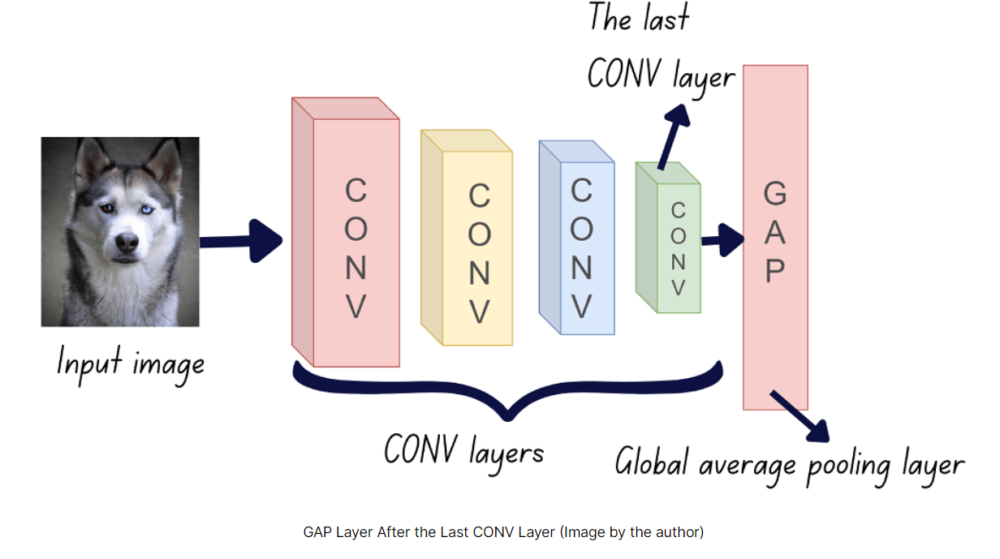

  2. Identifying Significance: This projection enables identification of which regions of the input image had a more pronounced influence on the final classification decision for a particular class. It creates a linkage between the learned weights in the output layer and the feature maps, highlighting where the network "looked" to make its decision.
  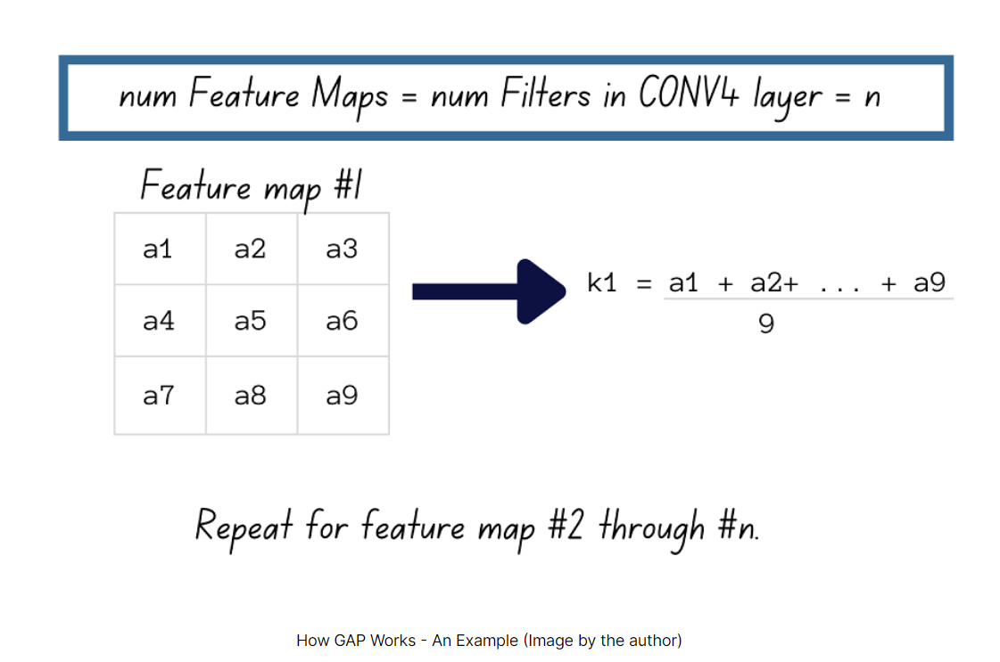
  
  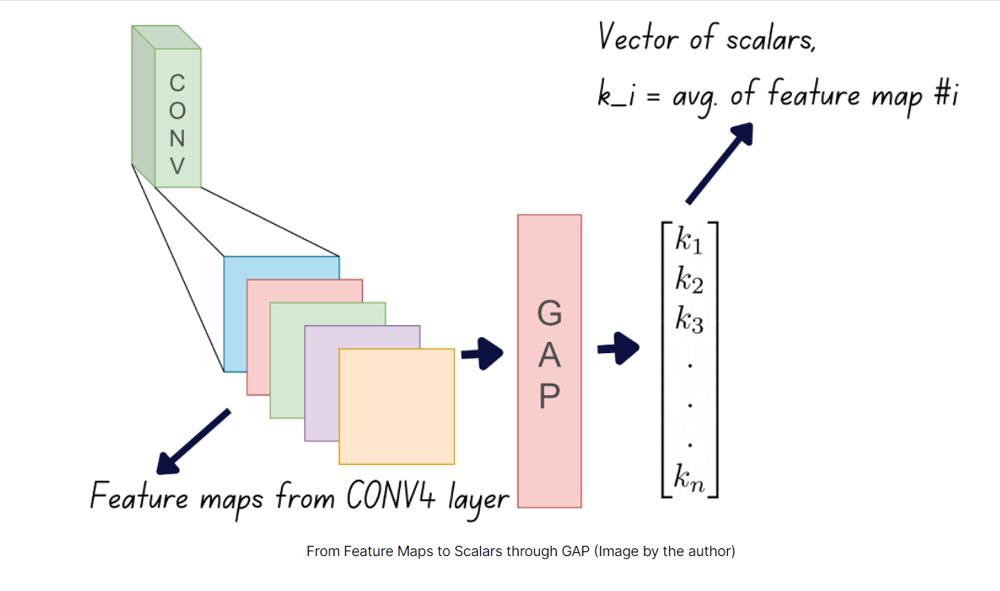

  3. Visualizing Importance: By mapping these weighted feature maps back onto the original image, CAM generates a heatmap. Higher intensity regions on this heatmap represent areas more influential in the network's decision for a particular class. These heatmaps serve as visual aids to comprehend what parts of the image were crucial in the classification process.
  
  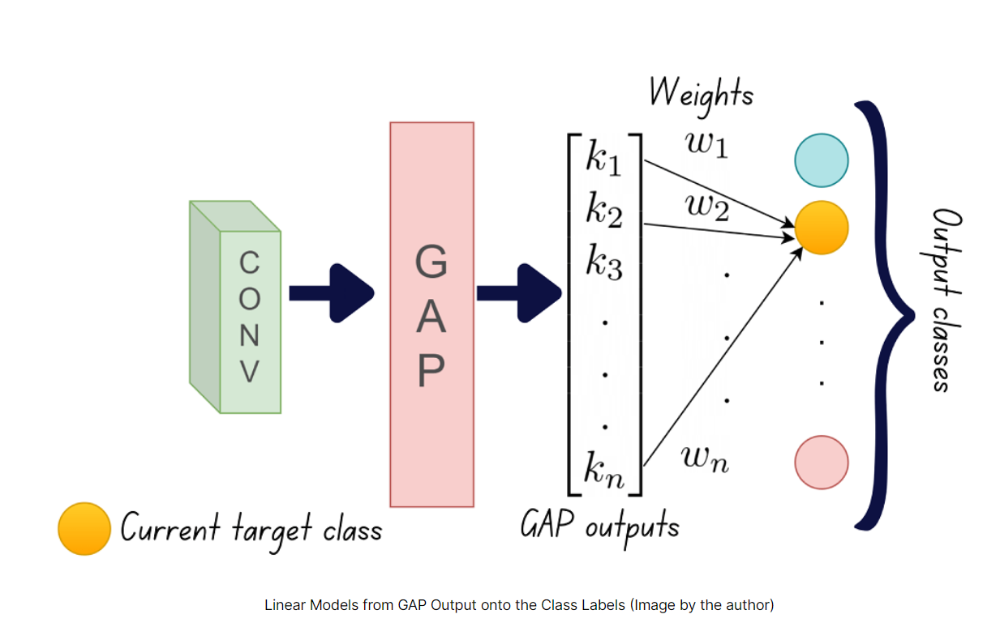
  
  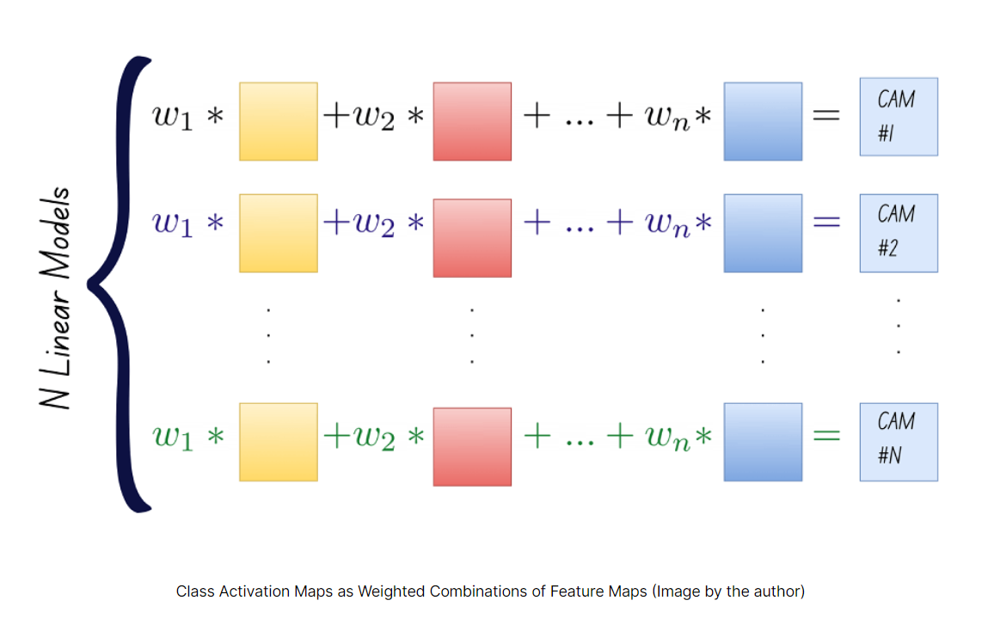
  
  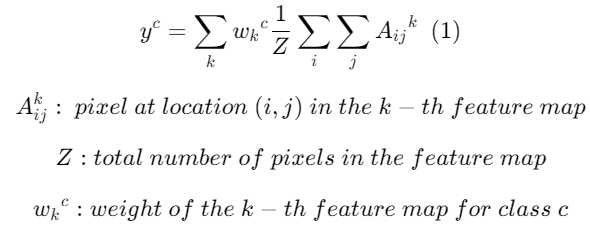

CAM Generation Procedure allows for an interpretable analysis of CNNs, revealing the specific areas of an image that contributed significantly to the network's classification decision-making process. This process aids in understanding the network's attention and focus during classification.

In [2]:
import matplotlib.pyplot as plt
import numpy as np
import cv2
cv2cmap = plt.colormaps['Reds']
import argparse

from torchvision import models, transforms
from torch.nn import functional as F
from torch import topk


# https://github.com/zhoubolei/CAM/blob/master/pytorch_CAM.py
def returnCAM(feature_conv, weight_softmax, class_idx):
    # generate the class activation maps upsample to 256x256
    size_upsample = (256, 256)
    bz, nc, h, w = feature_conv.shape
    output_cam = []
    for idx in class_idx:
        print(weight_softmax[idx].shape, feature_conv.reshape((nc, h*w)).shape)
        cam = weight_softmax[idx].dot(feature_conv.reshape((nc, h*w)))
        cam = cam.reshape(h, w)
        cam = cam - np.min(cam)
        cam_img = cam / np.max(cam)
        cam_img = np.uint8(255 * cam_img)
        output_cam.append(cv2.resize(cam_img, size_upsample))
    return output_cam

def show_cam(CAMs, width, height, orig_image, class_idx, all_classes, save_name,save_file_path):
    for i, cam in enumerate(CAMs):
        heatmap = cv2.applyColorMap(cv2.resize(cam,(width, height)), cv2.COLORMAP_JET)
        result = heatmap * 0.3 + orig_image * 0.5
        # put class label text on the result
        cv2.putText(result, all_classes[class_idx[i]], (20, 40),
                    cv2.FONT_HERSHEY_SIMPLEX, 1.5, (0, 255, 0), 2)
        # cv2.imshow('CAM', result/255.)
        # cv2.waitKey(0)
        cv2.imwrite(f"{save_file_path}{save_name}.jpg", result)

def load_synset_classes(file_path):
    # load the synset text file for labels
    all_classes = []
    with open(file_path, 'r') as f:
        all_lines = f.readlines()
        labels = [line.split('\n') for line in all_lines]
        for label_list in labels:
            current_class = [name.split(',') for name in label_list][0][0][10:]
            all_classes.append(current_class)
    return all_classes

# get all the classes in a list
all_classes = load_synset_classes('LOC_synset_mapping.txt')

# define the transforms, resize => tensor => normalize
transforms = transforms.Compose(
    [transforms.ToPILImage(),
     transforms.Resize((224, 224)),
     transforms.ToTensor(),
     transforms.Normalize(
        mean=[0.485, 0.456, 0.406],
        std=[0.229, 0.224, 0.225]
    )
    ])

# Discriminative region detection For classification

## Implementation of the CAM on Resnet50

In [4]:
# load the model
model = models.resnet50(pretrained=True).eval() ## ResNet50
# hook the feature extractor
def hook_feature(module, input, output):
    features_blobs.append(output.data.cpu().numpy())


In [5]:
image_save_path = [('input/One_object/image_','outputs/Resnet50/One_object/Resnet50_CAM_'), 
                   ('input/Two_objects/image_','outputs/Resnet50/Two_objects/Resnet50_CAM_'),
                   ('input/multi_objects/image_', 'outputs/Resnet50/multi_objects/Resnet50_CAM_')]
i = 0
number_file = 40 # for the one object folder
for image_path, save_file_path in image_save_path :
    if i == 40 :
        number_file = 20
    elif i == 20 :
        number_file = 10
    for i in range(1,number_file+1) : 
        filename = image_path + str(i) + '.jpg'
        # read and visualize the image 
        image = cv2.imread(filename)
        orig_image = image.copy()
        image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
        height, width, _ = image.shape

        features_blobs = []
        model._modules.get('layer4').register_forward_hook(hook_feature)
        # get the softmax weight
        params = list(model.parameters())
        weight_softmax = np.squeeze(params[-2].data.numpy())
        # apply the image transforms
        image_tensor = transforms(image)
        # add batch dimension
        image_tensor = image_tensor.unsqueeze(0)
        # forward pass through model
        outputs = model(image_tensor)
        # get the softmax probabilities
        probs = F.softmax(outputs).data.squeeze()
        # get the class indices of top k probabilities
    
        class_idx = topk(probs, 1)[1].int()
        # generate class activation mapping for the top1 prediction
        CAMs = returnCAM(features_blobs[0], weight_softmax, class_idx)
        # file name to save the resulting CAM image with
        save_name = f"{filename.split('/')[-1].split('.')[0]}"
        # show and save the results
        show_cam(CAMs, width, height, orig_image, class_idx, all_classes, save_name, save_file_path )


/tmp/ipykernel_3370/490858086.py:31: UserWarning: Implicit dimension choice for softmax has been deprecated. Change the call to include dim=X as an argument.
  probs = F.softmax(outputs).data.squeeze()


(2048,) (2048, 49)
(2048,) (2048, 49)
(2048,) (2048, 49)
(2048,) (2048, 49)
(2048,) (2048, 49)
(2048,) (2048, 49)
(2048,) (2048, 49)
(2048,) (2048, 49)
(2048,) (2048, 49)
(2048,) (2048, 49)
(2048,) (2048, 49)
(2048,) (2048, 49)
(2048,) (2048, 49)
(2048,) (2048, 49)
(2048,) (2048, 49)
(2048,) (2048, 49)
(2048,) (2048, 49)
(2048,) (2048, 49)
(2048,) (2048, 49)
(2048,) (2048, 49)
(2048,) (2048, 49)
(2048,) (2048, 49)
(2048,) (2048, 49)
(2048,) (2048, 49)
(2048,) (2048, 49)
(2048,) (2048, 49)
(2048,) (2048, 49)
(2048,) (2048, 49)
(2048,) (2048, 49)
(2048,) (2048, 49)
(2048,) (2048, 49)
(2048,) (2048, 49)
(2048,) (2048, 49)
(2048,) (2048, 49)
(2048,) (2048, 49)
(2048,) (2048, 49)
(2048,) (2048, 49)
(2048,) (2048, 49)
(2048,) (2048, 49)
(2048,) (2048, 49)
(2048,) (2048, 49)
(2048,) (2048, 49)
(2048,) (2048, 49)
(2048,) (2048, 49)
(2048,) (2048, 49)
(2048,) (2048, 49)
(2048,) (2048, 49)
(2048,) (2048, 49)
(2048,) (2048, 49)
(2048,) (2048, 49)
(2048,) (2048, 49)
(2048,) (2048, 49)
(2048,) (204

## Implementation of the CAM on ConNext_tiny

In [6]:
# load the model
model = models.convnext_tiny(weights= 'IMAGENET1K_V1').eval()
# hook the feature extractor
# https://github.com/zhoubolei/CAM/blob/master/pytorch_CAM.py

def hook_feature(module, input, output):
    features_blobs.append(output.data.cpu().numpy())

In [7]:
image_save_path = [('input/One_object/image_','outputs/Conv_next_tiny/One_object/Conv_next_tiny_CAM_'), 
                   ('input/Two_objects/image_','outputs/Conv_next_tiny/Two_objects/Conv_next_tiny_CAM_'),
                   ('input/multi_objects/image_', 'outputs/Conv_next_tiny/multi_objects/Conv_next_tiny_CAM_')]
i = 0
number_file = 40 # for the one object folder
for image_path, save_file_path in image_save_path :
    if i == 40 :
        number_file = 20
    elif i == 20 :
        number_file = 10
    for i in range(1,number_file+1) : 
        filename = image_path + str(i) + '.jpg'
        # read and visualize the image 
        image = cv2.imread(filename)
        orig_image = image.copy()
        image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
        height, width, _ = image.shape

        features_blobs = []
        model._modules.get('features').register_forward_hook(hook_feature)
        # get the softmax weight
        params = list(model.parameters())
        weight_softmax = np.squeeze(params[-2].data.numpy())
        # apply the image transforms
        image_tensor = transforms(image)
        # add batch dimension
        image_tensor = image_tensor.unsqueeze(0)
        # forward pass through model
        outputs = model(image_tensor)
        # get the softmax probabilities
        probs = F.softmax(outputs).data.squeeze()
        # get the class indices of top k probabilities
    
        class_idx = topk(probs, 1)[1].int()
        # generate class activation mapping for the top1 prediction
        CAMs = returnCAM(features_blobs[0], weight_softmax, class_idx)
        # file name to save the resulting CAM image with
        save_name = f"{filename.split('/')[-1].split('.')[0]}"
        # show and save the results
        show_cam(CAMs, width, height, orig_image, class_idx, all_classes, save_name, save_file_path )


/tmp/ipykernel_3370/1519468662.py:31: UserWarning: Implicit dimension choice for softmax has been deprecated. Change the call to include dim=X as an argument.
  probs = F.softmax(outputs).data.squeeze()


(768,) (768, 49)
(768,) (768, 49)
(768,) (768, 49)
(768,) (768, 49)
(768,) (768, 49)
(768,) (768, 49)
(768,) (768, 49)
(768,) (768, 49)
(768,) (768, 49)
(768,) (768, 49)
(768,) (768, 49)
(768,) (768, 49)
(768,) (768, 49)
(768,) (768, 49)
(768,) (768, 49)
(768,) (768, 49)
(768,) (768, 49)
(768,) (768, 49)
(768,) (768, 49)
(768,) (768, 49)
(768,) (768, 49)
(768,) (768, 49)
(768,) (768, 49)
(768,) (768, 49)
(768,) (768, 49)
(768,) (768, 49)
(768,) (768, 49)
(768,) (768, 49)
(768,) (768, 49)
(768,) (768, 49)
(768,) (768, 49)
(768,) (768, 49)
(768,) (768, 49)
(768,) (768, 49)
(768,) (768, 49)
(768,) (768, 49)
(768,) (768, 49)
(768,) (768, 49)
(768,) (768, 49)
(768,) (768, 49)
(768,) (768, 49)
(768,) (768, 49)
(768,) (768, 49)
(768,) (768, 49)
(768,) (768, 49)
(768,) (768, 49)
(768,) (768, 49)
(768,) (768, 49)
(768,) (768, 49)
(768,) (768, 49)
(768,) (768, 49)
(768,) (768, 49)
(768,) (768, 49)
(768,) (768, 49)
(768,) (768, 49)
(768,) (768, 49)
(768,) (768, 49)
(768,) (768, 49)
(768,) (768, 4

## Testing and result visualization

This stage of the work, consists of testing two main things:
    
    1. Each CNN's ability to classify the images (Accurate classification or not)
    
    2. To visually identify the parts of the images the CNNs based itself on to make the classification
    
    
To do so, Both Resnet50 and Convnext's classification abilities, were first tested on one single object image. Then on 2 different objects images. Finally on multiple object images. The results are to be observed in the following parts. 

### <center>One Object Image </center>

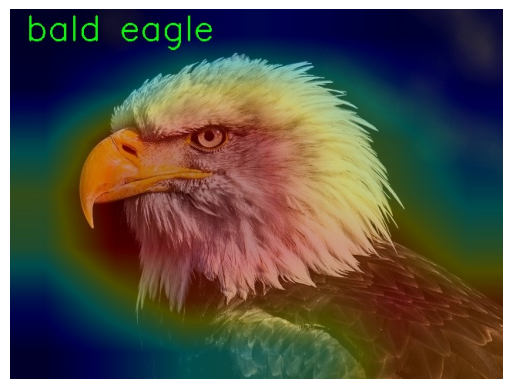

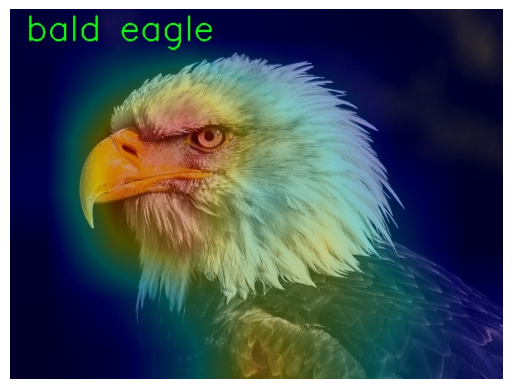

In [8]:
#resnet50CAM
image_1 = plt.imread('/homes/j23yapo/Téléchargements/outputs/Resnet50/One_object/Resnet50_CAM_image_2.jpg')
plt.imshow(image_1)
plt.axis('off')
plt.show()

#ConvnextinyCAM
image_2 = plt.imread('/homes/j23yapo/Téléchargements/outputs/Conv_next_tiny/One_object/Conv_next_tiny_CAM_image_2.jpg')
plt.imshow(image_2)
plt.axis('off')
plt.show()


Here both the Resnet50 and the Convnext, were able to correctly classify the images. 
   1. The first interresting part, is the fact, they they not only classified the image as a bird image, but they were both able to correctly identify the breed of the bird (Bald eagle).
   
   2. The second interresting fact, is that we can observe, thanks to the CAM, that both algorithms, based themselves on the right parts (pixels) of the image to make the classication. With that said, it's important to note, that the convnext, focused on  a narrower part of the image, mainly the head of the animal to make the classification, while the resnet50, took a greater part. 

### <center>Two Objects Images </center>

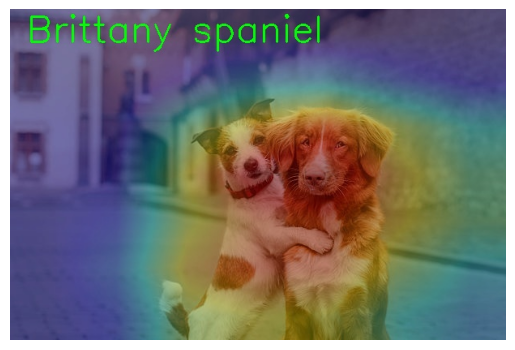

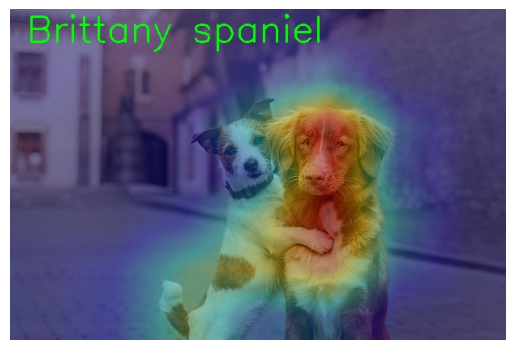

In [9]:
#resnet50CAM
image_1 = plt.imread('/homes/j23yapo/Téléchargements/outputs/Resnet50/Two_objects/Resnet50_CAM_image_2.jpg')
plt.imshow(image_1)
plt.axis('off')
plt.show()

#ConvnextinyCAM
image_2 = plt.imread('/homes/j23yapo/Téléchargements/outputs/Conv_next_tiny/Two_objects/Conv_next_tiny_CAM_image_2.jpg')
plt.imshow(image_2)
plt.axis('off')
plt.show()


Once  again both CNN, proved to be  quiet performant in the classification, as they both were able to identify the dog, despite the noise introduced (the second dog).
 1. Both CNNs, were unable to detect the fact that there were 2 different objects on the image, this makes sence, as they were both trained to detect only one object 
  2. They both based the classification on the bigger dog, and both picked a dog breed, that looks greatly similar to the actual dog in the image
  3. Once again, the Convnext, based the classification on  a narrower part of the image. we can obserc
  4. Despite being quiet similar, the fact that there were 2 different objects in the image influenced the classification ability. which led both CNNs, to identify the wrong breed of the dog

### <center>Multiple Objects Images </center>

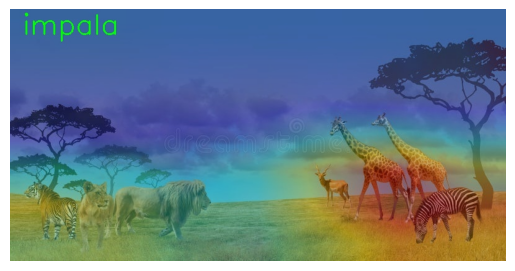

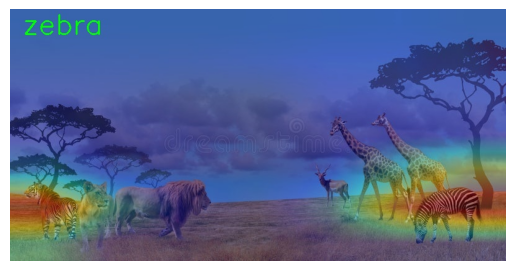

In [10]:
#resnet50CAM
image_1 = plt.imread('/homes/j23yapo/Téléchargements/outputs/Resnet50/multi_objects/Resnet50_CAM_image_9.jpg')
plt.imshow(image_1)
plt.axis('off')
plt.show()

#ConvnextinyCAM
image_2 = plt.imread('/homes/j23yapo/Téléchargements/outputs/Conv_next_tiny/multi_objects/Conv_next_tiny_CAM_image_9.jpg')
plt.imshow(image_2)
plt.axis('off')
plt.show()


The multi-object image classification turned out to be quiet challenging for both CNNs. both failed to identify the different objects in the image, once again, this makes total sense, they weren't designed to do so. With that said, it's important to mention that they both accuratly identified one of the objects amongs the others. 

    1. The resnet50 classified the image as one of an impala,but when trying to understand the reason behind this classification, using the CAM. One can notice, first that it has based itself on 2 different parts of the images ( this can be explained by the fact that there are 2 aggregations of animals on the image). But the tricky part, is the fact, that the higher focus was indeed on the side of the image where the impala was present, but but within this focus, there was as well a zebra, and 2 giraffes. at some point this can  jeopardise the credibility of the Resnet50 in this classification task. This means, that one can't be really sure about the credibility of classification of a resnet50 when it's given a noisy image.  
    
    2. The convnext on the other hand, Convnext_tiny, classified the above multi-object image as an image of a Zebra. like it's predecessor, it has based itself on2 different parts of the image. In the context of explaining the classification, the used CAM, shows that like the previous CNNs, it was able to know that there were 2 different aggregations in the image. And as metioned previously, since it focuses the classification on narrower parts of the image. it was able, to accuratly identify the  object it was focused on to make this classification (the stripes). 

# <center> OBJECT DETECTION </center>

In [1]:
#library importing
import warnings
warnings.filterwarnings('ignore')
warnings.simplefilter('ignore')
import cv2
import numpy as np
import torch
import torchvision

## Oject detection main code

In [2]:
def predict(input_tensor, model, device, detection_threshold):
    outputs = model(input_tensor)
    pred_classes = [coco_names[i] for i in outputs[0]['labels'].cpu().numpy()]
    pred_labels = outputs[0]['labels'].cpu().numpy()
    pred_scores = outputs[0]['scores'].detach().cpu().numpy()
    pred_bboxes = outputs[0]['boxes'].detach().cpu().numpy()
    
    boxes, classes, labels, indices = [], [], [], []
    for index in range(len(pred_scores)):
        if pred_scores[index] >= detection_threshold:
            boxes.append(pred_bboxes[index].astype(np.int32))
            classes.append(pred_classes[index])
            labels.append(pred_labels[index])
            indices.append(index)
    boxes = np.int32(boxes)
    return boxes, classes, labels, indices

def draw_boxes(boxes, labels, classes, image):
    for i, box in enumerate(boxes):
        color = COLORS[labels[i]]
        cv2.rectangle(
            image,
            (int(box[0]), int(box[1])),
            (int(box[2]), int(box[3])),
            color, 2
        )
        cv2.putText(image, classes[i], (int(box[0]), int(box[1] - 5)),
                    cv2.FONT_HERSHEY_SIMPLEX, 0.8, color, 2,
                    lineType=cv2.LINE_AA)
    return image

coco_names = ['__background__', 'person', 'bicycle', 'car', 'motorcycle', 'airplane', \
              'bus', 'train', 'truck', 'boat', 'traffic light', 'fire hydrant', 'N/A', 
              'stop sign', 'parking meter', 'bench', 'bird', 'cat', 'dog', 'horse', 'sheep', 
              'cow', 'elephant', 'bear', 'zebra', 'giraffe', 'N/A', 'backpack', 'umbrella',
              'N/A', 'N/A', 'handbag', 'tie', 'suitcase', 'frisbee', 'skis', 'snowboard',
              'sports ball', 'kite', 'baseball bat', 'baseball glove', 'skateboard',
              'surfboard', 'tennis racket', 'bottle', 'N/A', 'wine glass', 'cup', 'fork',
              'knife', 'spoon', 'bowl', 'banana', 'apple', 'sandwich', 'orange',
              'broccoli', 'carrot', 'hot dog', 'pizza', 'donut', 'cake', 'chair', 'couch',
              'potted plant', 'bed', 'N/A', 'dining table', 'N/A', 'N/A', 'toilet',
              'N/A', 'tv', 'laptop', 'mouse', 'remote', 'keyboard', 'cell phone', 'microwave',
              'oven', 'toaster', 'sink', 'refrigerator', 'N/A', 'book', 'clock', 'vase',
              'scissors', 'teddy bear', 'hair drier', 'toothbrush']


# This will help us create a different color for each class
COLORS = np.random.uniform(0, 255, size=(len(coco_names), 3))

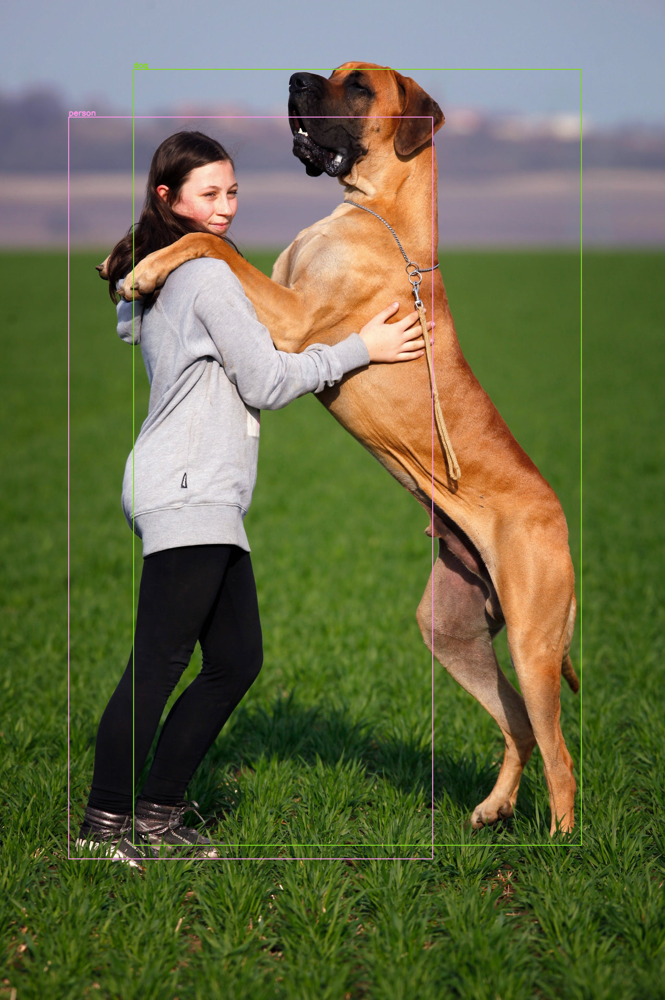

In [3]:
import requests
from PIL import Image
image = np.array(Image.open("/homes/j23yapo/Téléchargements/input/object_detection_image_3.jpg"))
image_float_np = np.float32(image) / 255
# define the torchvision image transforms
transform = torchvision.transforms.Compose([
    torchvision.transforms.ToTensor(),
])

input_tensor = transform(image)
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
input_tensor = input_tensor.to(device)
# Add a batch dimension:/
input_tensor = input_tensor.unsqueeze(0)

model = torchvision.models.detection.fasterrcnn_resnet50_fpn_v2(pretrained=True)
model.eval().to(device)

# Run the model and display the detections
boxes, classes, labels, indices = predict(input_tensor, model, device, 0.9)
image = draw_boxes(boxes, labels, classes, image)

# Show the image:
Image.fromarray(image)

The above used CNN, is not only able to recognize that the image contains 2 different objects, but it's also able to label each of them. it's important to note some few, quiet important aspects about it. 
  1. it was able to distinguish between both objects, despite them being entangled to each other, this proves the precicion of the fasterrcnn in the object detection task
  2. The second important thing to note, is the fact, that among all CNNs that have been used during this project, this CNN is the only one, that is able to recognize a human being, and classify it as person

## Eigen CAM Main Code

In [4]:
import matplotlib
from matplotlib import pyplot as plt
from matplotlib.lines import Line2D
import cv2
import numpy as np
import torch
from torchvision.transforms import Compose, Normalize, ToTensor
from typing import List, Dict
import math


def preprocess_image(
    img: np.ndarray, mean=[
        0.5, 0.5, 0.5], std=[
            0.5, 0.5, 0.5]) -> torch.Tensor:
    preprocessing = Compose([
        ToTensor(),
        Normalize(mean=mean, std=std)
    ])
    return preprocessing(img.copy()).unsqueeze(0)


def deprocess_image(img):
    """ see https://github.com/jacobgil/keras-grad-cam/blob/master/grad-cam.py#L65 """
    img = img - np.mean(img)
    img = img / (np.std(img) + 1e-5)
    img = img * 0.1
    img = img + 0.5
    img = np.clip(img, 0, 1)
    return np.uint8(img * 255)


def show_cam_on_image(img: np.ndarray,
                      mask: np.ndarray,
                      use_rgb: bool = False,
                      colormap: int = cv2.COLORMAP_JET,
                      image_weight: float = 0.5) -> np.ndarray:
    """ This function overlays the cam mask on the image as an heatmap.
    By default the heatmap is in BGR format.

    :param img: The base image in RGB or BGR format.
    :param mask: The cam mask.
    :param use_rgb: Whether to use an RGB or BGR heatmap, this should be set to True if 'img' is in RGB format.
    :param colormap: The OpenCV colormap to be used.
    :param image_weight: The final result is image_weight * img + (1-image_weight) * mask.
    :returns: The default image with the cam overlay.
    """
    heatmap = cv2.applyColorMap(np.uint8(255 * mask), colormap)
    if use_rgb:
        heatmap = cv2.cvtColor(heatmap, cv2.COLOR_BGR2RGB)
    heatmap = np.float32(heatmap) / 255

    if np.max(img) > 1:
        raise Exception(
            "The input image should np.float32 in the range [0, 1]")

    if image_weight < 0 or image_weight > 1:
        raise Exception(
            f"image_weight should be in the range [0, 1].\
                Got: {image_weight}")

    cam = (1 - image_weight) * heatmap + image_weight * img
    cam = cam / np.max(cam)
    return np.uint8(255 * cam)


def create_labels_legend(concept_scores: np.ndarray,
                         labels: Dict[int, str],
                         top_k=2):
    concept_categories = np.argsort(concept_scores, axis=1)[:, ::-1][:, :top_k]
    concept_labels_topk = []
    for concept_index in range(concept_categories.shape[0]):
        categories = concept_categories[concept_index, :]
        concept_labels = []
        for category in categories:
            score = concept_scores[concept_index, category]
            label = f"{','.join(labels[category].split(',')[:3])}:{score:.2f}"
            concept_labels.append(label)
        concept_labels_topk.append("\n".join(concept_labels))
    return concept_labels_topk


def show_factorization_on_image(img: np.ndarray,
                                explanations: np.ndarray,
                                colors: List[np.ndarray] = None,
                                image_weight: float = 0.5,
                                concept_labels: List = None) -> np.ndarray:
    """ Color code the different component heatmaps on top of the image.
        Every component color code will be magnified according to the heatmap itensity
        (by modifying the V channel in the HSV color space),
        and optionally create a lagend that shows the labels.

        Since different factorization component heatmaps can overlap in principle,
        we need a strategy to decide how to deal with the overlaps.
        This keeps the component that has a higher value in it's heatmap.

    :param img: The base image RGB format.
    :param explanations: A tensor of shape num_componetns x height x width, with the component visualizations.
    :param colors: List of R, G, B colors to be used for the components.
                   If None, will use the gist_rainbow cmap as a default.
    :param image_weight: The final result is image_weight * img + (1-image_weight) * visualization.
    :concept_labels: A list of strings for every component. If this is paseed, a legend that shows
                     the labels and their colors will be added to the image.
    :returns: The visualized image.
    """
    n_components = explanations.shape[0]
    if colors is None:
        # taken from https://github.com/edocollins/DFF/blob/master/utils.py
        _cmap = plt.cm.get_cmap('gist_rainbow')
        colors = [
            np.array(
                _cmap(i)) for i in np.arange(
                0,
                1,
                1.0 /
                n_components)]
    concept_per_pixel = explanations.argmax(axis=0)
    masks = []
    for i in range(n_components):
        mask = np.zeros(shape=(img.shape[0], img.shape[1], 3))
        mask[:, :, :] = colors[i][:3]
        explanation = explanations[i]
        explanation[concept_per_pixel != i] = 0
        mask = np.uint8(mask * 255)
        mask = cv2.cvtColor(mask, cv2.COLOR_RGB2HSV)
        mask[:, :, 2] = np.uint8(255 * explanation)
        mask = cv2.cvtColor(mask, cv2.COLOR_HSV2RGB)
        mask = np.float32(mask) / 255
        masks.append(mask)

    mask = np.sum(np.float32(masks), axis=0)
    result = img * image_weight + mask * (1 - image_weight)
    result = np.uint8(result * 255)

    if concept_labels is not None:
        px = 1 / plt.rcParams['figure.dpi']  # pixel in inches
        fig = plt.figure(figsize=(result.shape[1] * px, result.shape[0] * px))
        plt.rcParams['legend.fontsize'] = int(
            14 * result.shape[0] / 256 / max(1, n_components / 6))
        lw = 5 * result.shape[0] / 256
        lines = [Line2D([0], [0], color=colors[i], lw=lw)
                 for i in range(n_components)]
        plt.legend(lines,
                   concept_labels,
                   mode="expand",
                   fancybox=True,
                   shadow=True)

        plt.tight_layout(pad=0, w_pad=0, h_pad=0)
        plt.axis('off')
        fig.canvas.draw()
        data = np.frombuffer(fig.canvas.tostring_rgb(), dtype=np.uint8)
        plt.close(fig=fig)
        data = data.reshape(fig.canvas.get_width_height()[::-1] + (3,))
        data = cv2.resize(data, (result.shape[1], result.shape[0]))
        result = np.hstack((result, data))
    return result


def scale_cam_image(cam, target_size=None):
    result = []
    for img in cam:
        img = img - np.min(img)
        img = img / (1e-7 + np.max(img))
        if target_size is not None:
            img = cv2.resize(img, target_size)
        result.append(img)
    result = np.float32(result)

    return result


def scale_accross_batch_and_channels(tensor, target_size):
    batch_size, channel_size = tensor.shape[:2]
    reshaped_tensor = tensor.reshape(
        batch_size * channel_size, *tensor.shape[2:])
    result = scale_cam_image(reshaped_tensor, target_size)
    result = result.reshape(
        batch_size,
        channel_size,
        target_size[1],
        target_size[0])
    return result

class ClassifierOutputTarget:
    def __init__(self, category):
        self.category = category

    def __call__(self, model_output):
        if len(model_output.shape) == 1:
            return model_output[self.category]
        return model_output[:, self.category]


In [5]:
class ActivationsAndGradients:
    """ Class for extracting activations and
    registering gradients from targetted intermediate layers """

    def __init__(self, model, target_layers, reshape_transform):
        self.model = model
        self.gradients = []
        self.activations = []
        self.reshape_transform = reshape_transform
        self.handles = []
        for target_layer in target_layers:
            self.handles.append(
                target_layer.register_forward_hook(self.save_activation))
            # Because of https://github.com/pytorch/pytorch/issues/61519,
            # we don't use backward hook to record gradients.
            self.handles.append(
                target_layer.register_forward_hook(self.save_gradient))

    def save_activation(self, module, input, output):
        activation = output

        if self.reshape_transform is not None:
            activation = self.reshape_transform(activation)
        self.activations.append(activation.cpu().detach())

    def save_gradient(self, module, input, output):
        if not hasattr(output, "requires_grad") or not output.requires_grad:
            # You can only register hooks on tensor requires grad.
            return

        # Gradients are computed in reverse order
        def _store_grad(grad):
            if self.reshape_transform is not None:
                grad = self.reshape_transform(grad)
            self.gradients = [grad.cpu().detach()] + self.gradients

        output.register_hook(_store_grad)

    def __call__(self, x):
        self.gradients = []
        self.activations = []
        return self.model(x)

    def release(self):
        for handle in self.handles:
            handle.remove()

In [6]:
def get_2d_projection(activation_batch):
    # TBD: use pytorch batch svd implementation
    activation_batch[np.isnan(activation_batch)] = 0
    projections = []
    for activations in activation_batch:
        reshaped_activations = (activations).reshape(
            activations.shape[0], -1).transpose()
        # Centering before the SVD seems to be important here,
        # Otherwise the image returned is negative
        reshaped_activations = reshaped_activations - \
            reshaped_activations.mean(axis=0)
        U, S, VT = np.linalg.svd(reshaped_activations, full_matrices=True)
        projection = reshaped_activations @ VT[0, :]
        projection = projection.reshape(activations.shape[1:])
        projections.append(projection)
    return np.float32(projections)

In [7]:
import ttach as tta
from typing import Callable, List, Tuple

class BaseCAM:
    def __init__(self,
                 model: torch.nn.Module,
                 target_layers: List[torch.nn.Module],
                 use_cuda: bool = False,
                 reshape_transform: Callable = None,
                 compute_input_gradient: bool = False,
                 uses_gradients: bool = True) -> None:
        self.model = model.eval()
        self.target_layers = target_layers
        self.cuda = use_cuda
        if self.cuda:
            self.model = model.cuda()
        self.reshape_transform = reshape_transform
        self.compute_input_gradient = compute_input_gradient
        self.uses_gradients = uses_gradients
        self.activations_and_grads = ActivationsAndGradients(
            self.model, target_layers, reshape_transform)

    """ Get a vector of weights for every channel in the target layer.
        Methods that return weights channels,
        will typically need to only implement this function. """

    def get_cam_weights(self,
                        input_tensor: torch.Tensor,
                        target_layers: List[torch.nn.Module],
                        targets: List[torch.nn.Module],
                        activations: torch.Tensor,
                        grads: torch.Tensor) -> np.ndarray:
        raise Exception("Not Implemented")

    def get_cam_image(self,
                      input_tensor: torch.Tensor,
                      target_layer: torch.nn.Module,
                      targets: List[torch.nn.Module],
                      activations: torch.Tensor,
                      grads: torch.Tensor,
                      eigen_smooth: bool = False) -> np.ndarray:

        weights = self.get_cam_weights(input_tensor,
                                       target_layer,
                                       targets,
                                       activations,
                                       grads)
        weighted_activations = weights[:, :, None, None] * activations
        if eigen_smooth:
            cam = get_2d_projection(weighted_activations)
        else:
            cam = weighted_activations.sum(axis=1)
        return cam

    def forward(self,
                input_tensor: torch.Tensor,
                targets: List[torch.nn.Module],
                eigen_smooth: bool = False) -> np.ndarray:

        if self.cuda:
            input_tensor = input_tensor.cuda()

        if self.compute_input_gradient:
            input_tensor = torch.autograd.Variable(input_tensor,
                                                   requires_grad=True)

        outputs = self.activations_and_grads(input_tensor)
        if targets is None:
            target_categories = np.argmax(outputs.cpu().data.numpy(), axis=-1)
            targets = [ClassifierOutputTarget(
                category) for category in target_categories]

        if self.uses_gradients:
            self.model.zero_grad()
            loss = sum([target(output)
                       for target, output in zip(targets, outputs)])
            loss.backward(retain_graph=True)

        # In most of the saliency attribution papers, the saliency is
        # computed with a single target layer.
        # Commonly it is the last convolutional layer.
        # Here we support passing a list with multiple target layers.
        # It will compute the saliency image for every image,
        # and then aggregate them (with a default mean aggregation).
        # This gives you more flexibility in case you just want to
        # use all conv layers for example, all Batchnorm layers,
        # or something else.
        cam_per_layer = self.compute_cam_per_layer(input_tensor,
                                                   targets,
                                                   eigen_smooth)
        return self.aggregate_multi_layers(cam_per_layer)

    def get_target_width_height(self,
                                input_tensor: torch.Tensor) -> Tuple[int, int]:
        width, height = input_tensor.size(-1), input_tensor.size(-2)
        return width, height

    def compute_cam_per_layer(
            self,
            input_tensor: torch.Tensor,
            targets: List[torch.nn.Module],
            eigen_smooth: bool) -> np.ndarray:
        activations_list = [a.cpu().data.numpy()
                            for a in self.activations_and_grads.activations]
        grads_list = [g.cpu().data.numpy()
                      for g in self.activations_and_grads.gradients]
        target_size = self.get_target_width_height(input_tensor)

        cam_per_target_layer = []
        # Loop over the saliency image from every layer
        for i in range(len(self.target_layers)):
            target_layer = self.target_layers[i]
            layer_activations = None
            layer_grads = None
            if i < len(activations_list):
                layer_activations = activations_list[i]
            if i < len(grads_list):
                layer_grads = grads_list[i]

            cam = self.get_cam_image(input_tensor,
                                     target_layer,
                                     targets,
                                     layer_activations,
                                     layer_grads,
                                     eigen_smooth)
            cam = np.maximum(cam, 0)
            scaled = scale_cam_image(cam, target_size)
            cam_per_target_layer.append(scaled[:, None, :])

        return cam_per_target_layer

    def aggregate_multi_layers(
            self,
            cam_per_target_layer: np.ndarray) -> np.ndarray:
        cam_per_target_layer = np.concatenate(cam_per_target_layer, axis=1)
        cam_per_target_layer = np.maximum(cam_per_target_layer, 0)
        result = np.mean(cam_per_target_layer, axis=1)
        return scale_cam_image(result)

    def forward_augmentation_smoothing(self,
                                       input_tensor: torch.Tensor,
                                       targets: List[torch.nn.Module],
                                       eigen_smooth: bool = False) -> np.ndarray:
        transforms = tta.Compose(
            [
                tta.HorizontalFlip(),
                tta.Multiply(factors=[0.9, 1, 1.1]),
            ]
        )
        cams = []
        for transform in transforms:
            augmented_tensor = transform.augment_image(input_tensor)
            cam = self.forward(augmented_tensor,
                               targets,
                               eigen_smooth)

            # The ttach library expects a tensor of size BxCxHxW
            cam = cam[:, None, :, :]
            cam = torch.from_numpy(cam)
            cam = transform.deaugment_mask(cam)

            # Back to numpy float32, HxW
            cam = cam.numpy()
            cam = cam[:, 0, :, :]
            cams.append(cam)

        cam = np.mean(np.float32(cams), axis=0)
        return cam

    def __call__(self,
                 input_tensor: torch.Tensor,
                 targets: List[torch.nn.Module] = None,
                 aug_smooth: bool = False,
                 eigen_smooth: bool = False) -> np.ndarray:

        # Smooth the CAM result with test time augmentation
        if aug_smooth is True:
            return self.forward_augmentation_smoothing(
                input_tensor, targets, eigen_smooth)

        return self.forward(input_tensor,
                            targets, eigen_smooth)

    def __del__(self):
        self.activations_and_grads.release()

    def __enter__(self):
        return self

    def __exit__(self, exc_type, exc_value, exc_tb):
        self.activations_and_grads.release()
        if isinstance(exc_value, IndexError):
            # Handle IndexError here...
            print(
                f"An exception occurred in CAM with block: {exc_type}. Message: {exc_value}")
            return True

In [8]:
# https://arxiv.org/abs/2008.00299


class EigenCAM(BaseCAM):
    def __init__(self, model, target_layers, use_cuda=False,
                 reshape_transform=None):
        super(EigenCAM, self).__init__(model,
                                       target_layers,
                                       use_cuda,
                                       reshape_transform,
                                       uses_gradients=False)

    def get_cam_image(self,
                      input_tensor,
                      target_layer,
                      target_category,
                      activations,
                      grads,
                      eigen_smooth):
        return get_2d_projection(activations)

In [9]:
def fasterrcnn_reshape_transform(x):
    target_size = x['pool'].size()[-2 : ]
    activations = []
    for key, value in x.items():
        activations.append(torch.nn.functional.interpolate(torch.abs(value), target_size, mode='bilinear'))
    activations = torch.cat(activations, axis=1)
    return activations

In [10]:
class FasterRCNNBoxScoreTarget:
    """ For every original detected bounding box specified in "bounding boxes",
    	assign a score on how the current bounding boxes match it,
    		1. In IOU
    		2. In the classification score.
    	If there is not a large enough overlap, or the category changed,
    	assign a score of 0.

    	The total score is the sum of all the box scores.
    """

    def __init__(self, labels, bounding_boxes, iou_threshold=0.5):
        self.labels = labels
        self.bounding_boxes = bounding_boxes
        self.iou_threshold = iou_threshold

    def __call__(self, model_outputs):
        output = torch.Tensor([0])
        if torch.cuda.is_available():
            output = output.cuda()

        if len(model_outputs["boxes"]) == 0:
            return output

        for box, label in zip(self.bounding_boxes, self.labels):
            box = torch.Tensor(box[None, :])
            if torch.cuda.is_available():
                box = box.cuda()

            ious = torchvision.ops.box_iou(box, model_outputs["boxes"])
            index = ious.argmax()
            if ious[0, index] > self.iou_threshold and model_outputs["labels"][index] == label:
                score = ious[0, index] + model_outputs["scores"][index]
                output = output + score
        return output

## Visualization of the CAM apllied on fasterrcnn_resnet50_fpn_v2

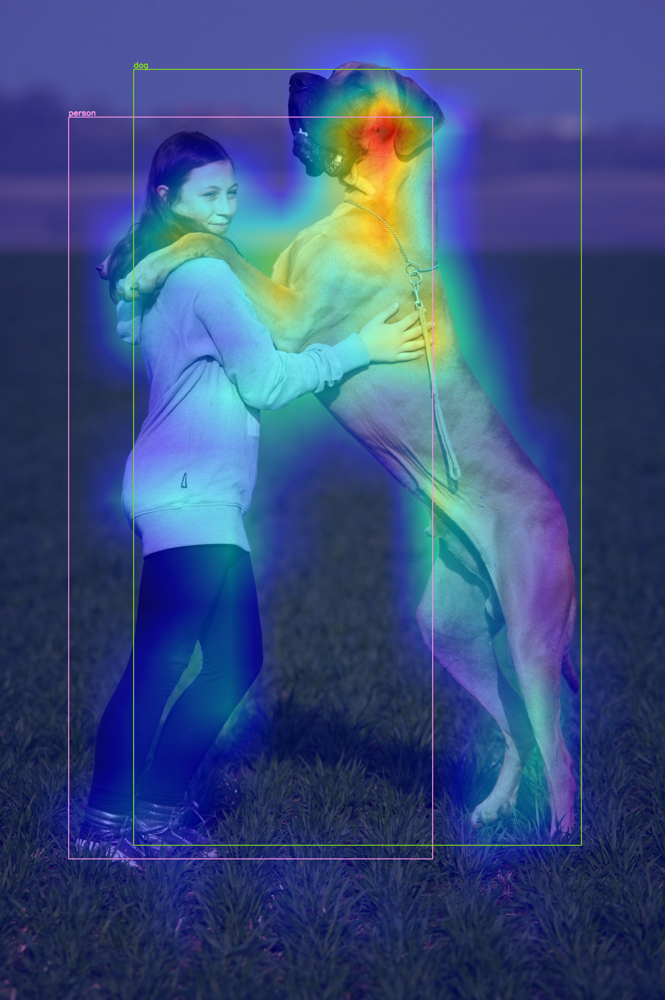

In [12]:
target_layers = [model.backbone]
targets = [FasterRCNNBoxScoreTarget(labels=labels, bounding_boxes=boxes)]
cam = EigenCAM(model,
               target_layers, 
               use_cuda=torch.cuda.is_available(),
               reshape_transform=fasterrcnn_reshape_transform)

grayscale_cam = cam(input_tensor, targets=targets)
# Take the first image in the batch:
grayscale_cam = grayscale_cam[0, :]
cam_image = show_cam_on_image(image_float_np, grayscale_cam, use_rgb=True)
# And lets draw the boxes again:
image_with_bounding_boxes = draw_boxes(boxes, labels, classes, cam_image)
Image.fromarray(image_with_bounding_boxes)

The above CAM further emphasizes the ability of the CNN, to base itself on the right pixels of the image to make its classification. When looking at the above cam, one can notice, that for both detected object, the classification was made accurately on the right parts of the images to make the classification. 

One can as well notice, that the heatmap, shows warmer parts for the Dog's part of the image, this can be explained by the fact, that the dog and the person are entangles into each other, and the dog being bigger, it might have been given higher scalars, hence this difference in the heatmap

**LIMITATION**
It has been noticed and proved that the CAM works really well classification models, as it's able to accuratly show the pixels the model was based on to make the classification. 
However, For the object detection, the CAM, shows some limitation, as for an image, that contains multiple objects, it's not always able to detect all the objects within the image. This suggest, that it be a good hint to use some other Class activation maps or slightly modify them to get better results. 